In [3]:
import numpy as np
import math 
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
import pandas as pd
import plotly.express as px

In [4]:

class Spring():
    def __init__(self, equilLength, k):
        self.equilLength = equilLength
        self.k = k

class Mass():
    def __init__(self, x,y, mass):
        self.x = x
        self.y = y
        self.accelX = 0
        self.accelY = 0
        self.velX = 0
        self.velY = 0
        self.mass = mass
        self.forcesX = []
        self.forcesY = []
    
    def calcForce(self, offsetX, offsetY, otherMass, spring):
        difBehindY = (self.y + offsetY - otherMass.y)
        difBehindX = (self.x + offsetX - otherMass.x)
        forceBehind = spring.k * np.abs(spring.equilLength - np.sqrt(difBehindY**2 + difBehindX**2))
        forceBehindAngle = math.atan2(difBehindY,difBehindX) - math.radians(180)
        forceBehindX = forceBehind*np.cos(forceBehindAngle)
        forceBehindY = forceBehind*np.sin(forceBehindAngle)
        self.forcesX.append(forceBehindX)
        self.forcesY.append(forceBehindY)
    
    def returnAppliedForce(self, dt):
        self.accelX = (sum(self.forcesX))/self.mass
        self.accelY = (sum(self.forcesY))/self.mass

        #Acceleration steps
        self.velX += self.accelX * dt
        self.velY += self.accelY * dt
        
        self.forcesX = []
        self.forcesY = []

        return self.velX * dt, self.velY * dt

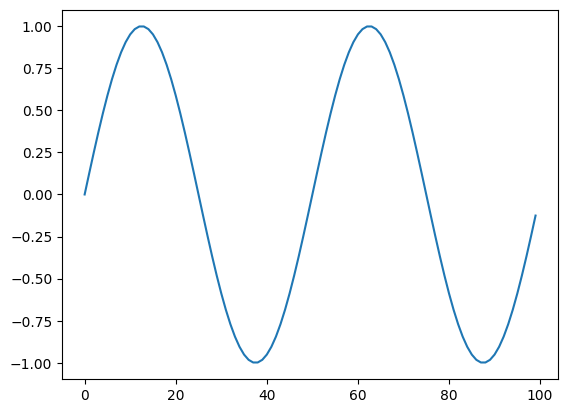

In [132]:
# Setting up masses
masses = []
springs = []

startPos =  (0,0)
pickedPoint = (50,1)


numOfMasses = 100
fullLengthPulled = 100

endPos = (startPos[0] + fullLengthPulled, startPos[1])

k = 3
eachMassLength = fullLengthPulled/numOfMasses
equiplibreiumLength = 60
equiplibreiumLengthPerMass = equiplibreiumLength/numOfMasses
totalMass = 1
massPerMass = totalMass/numOfMasses

for i in range(numOfMasses):
    masses.append(Mass(startPos[0] + i * eachMassLength, startPos[1], massPerMass))
for i in range(1,numOfMasses):
    springs.append(Spring(equiplibreiumLengthPerMass, k))

#Line pick

# for i, mass in enumerate(masses):
#     if i < pickedPoint[0]:
#         mass.y = ((pickedPoint[1] - startPos[1])/(pickedPoint[0] - startPos[0]))*(mass.x - startPos[0]) + startPos[1]
#     elif i > pickedPoint[0]:
#         mass.y = ((endPos[1] - pickedPoint[1])/(endPos[0] - pickedPoint[0]))*(mass.x - pickedPoint[0]) + pickedPoint[1]
#masses[pickedPoint[0]].y = pickedPoint[1]

# Sin wave
nodes = 2
for i, mass in enumerate(masses):
    mass.y = math.sin(mass.x * 2 * math.pi * 2/numOfMasses)



#guasNum = 30
#damp = 30000000
#length = 50
#startI = round(numOfMasses/2) - round(guasNum/2)
#for i in range(guasNum):
    #springs[int(startI + i)].y = (math.e**-((i + length)**2)/length)*damp
    #print((math.e**-((i)**2)/length)*damp)

xs = [i.x for i in masses]
ys = [i.y for i in masses]
plt.plot(xs, ys)

In [133]:
dt = 0.01

def sim():
    for i in range(1, len(masses) - 1):
        mass = masses[i]
        spring = springs[i]

        #K0
        for j in [1,-1]:
            mass.calcForce(0,0, masses[i+j], spring)
        
        k0x, k0y = mass.returnAppliedForce(dt)

        #K1
        for j in [1,-1]:
            mass.calcForce(k0x/2,k0y/2, masses[i+j], spring)
    
    for i in range(1, len(masses) - 1):
        mass = masses[i]
        movement = mass.returnAppliedForce(dt/2)
        mass.x += movement[0]
        mass.y += movement[1]
            
pos = {'x' : [], 'y' : [], 'time' : [], 'id' : []}
#data = pd.DataFrame(pos)
for i in range(1000):
    sim()
    for num, j in enumerate(masses):
        pos['x'].append(j.x)
        pos['y'].append(j.y)
        pos['time'].append(i)
        pos['id'].append(num)
        #data.loc[len(data.index)] = [j.x, j.y, i, num]
#print(data)
#fig = px.line(pos, x="x", y="y", title='is a stirng', animation_frame="time", hover_name='id')
fig = px.scatter(pos, x="x", y="y", title='is a stirng', animation_frame="time", hover_name='id')
fig.layout.xaxis.range = (-0,fullLengthPulled)
fig.layout.yaxis.range = (-1,1)
fig.show()


#animation = FuncAnimation(fig, sim, frames = range(1,500))
#animation.save("spring.gif", dpi = 300, writer = PillowWriter(fps=30))

In [7]:
data = pd.DataFrame(pos)
print(data)
amoungs = data.loc[data['id'] == 12]
print(amoungs)
fig2 = px.scatter(amoungs, x = "time", y="y", title='is a stirng', hover_name='id')
fig2.show()


               x         y  time  id
0       0.000000  0.000000     0   0
1       0.999943  0.124807     0   1
2       1.999889  0.247647     0   2
3       2.999841  0.366584     0   3
4       3.999804  0.479742     0   4
...          ...       ...   ...  ..
99995  95.000001 -0.117298   999  95
99996  96.000001 -0.119304   999  96
99997  97.000001 -0.121312   999  97
99998  98.000000 -0.123322   999  98
99999  99.000000 -0.125333   999  99

[100000 rows x 4 columns]
               x         y  time  id
12     11.999970  0.993934     0  12
112    11.999937  0.986583     1  12
212    11.999910  0.976654     2  12
312    11.999894  0.964704     3  12
412    11.999889  0.951184     4  12
...          ...       ...   ...  ..
99512  12.000003 -0.006793   995  12
99612  12.000003 -0.006804   996  12
99712  12.000003 -0.006814   997  12
99812  12.000003 -0.006824   998  12
99912  12.000003 -0.006834   999  12

[1000 rows x 4 columns]


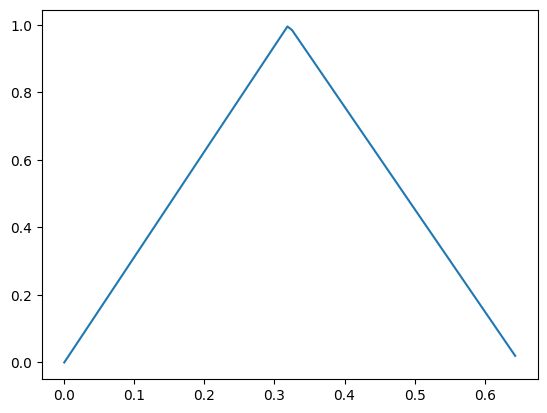

In [84]:
# Setting up masses
masses = []
springs = []

startPos =  (0,0)
pickedPoint = (0.32,1)


numOfMasses = 100
fullLengthPulled = 0.65

endPos = (startPos[0] + fullLengthPulled, startPos[1])

#k = 145.76
k = 1.4576
eachMassLength = fullLengthPulled/numOfMasses
equiplibreiumLength = 0.617
equiplibreiumLengthPerMass = equiplibreiumLength/numOfMasses
totalMass = 0.00028
massPerMass = totalMass/numOfMasses

for i in range(numOfMasses):
    masses.append(Mass(startPos[0] + i * eachMassLength, startPos[1], massPerMass))
for i in range(1,numOfMasses):
    springs.append(Spring(equiplibreiumLengthPerMass, k))

#Line pick

for i, mass in enumerate(masses):
    if mass.x < pickedPoint[0]:
        mass.y = ((pickedPoint[1] - startPos[1])/(pickedPoint[0] - startPos[0]))*(mass.x - startPos[0]) + startPos[1]
    elif mass.x > pickedPoint[0]:
        mass.y = ((endPos[1] - pickedPoint[1])/(endPos[0] - pickedPoint[0]))*(mass.x - pickedPoint[0]) + pickedPoint[1]
    else:
        masses[i].y = pickedPoint[1]

# Sin wave
#nodes = 2
#for i, mass in enumerate(masses):
#    mass.y = math.sin(mass.x * 2 * math.pi * 2/numOfMasses)



#guasNum = 30
#damp = 30000000
#length = 50
#startI = round(numOfMasses/2) - round(guasNum/2)
#for i in range(guasNum):
    #springs[int(startI + i)].y = (math.e**-((i + length)**2)/length)*damp
    #print((math.e**-((i)**2)/length)*damp)

xs = [i.x for i in masses]
ys = [i.y for i in masses]
plt.plot(xs, ys)

dt = 0.001

def sim():
    for i in range(1, len(masses) - 1):
        mass = masses[i]
        spring = springs[i]

        #K0
        for j in [1,-1]:
            mass.calcForce(0,0, masses[i+j], spring)
        
        k0x, k0y = mass.returnAppliedForce(dt)

        #K1
        for j in [1,-1]:
            mass.calcForce(k0x/2,k0y/2, masses[i+j], spring)
    
    for i in range(1, len(masses) - 1):
        mass = masses[i]
        movement = mass.returnAppliedForce(dt/2)
        mass.x += movement[0]
        mass.y += movement[1]
            
pos = {'x' : [], 'y' : [], 'time' : [], 'id' : []}
#data = pd.DataFrame(pos)
for i in range(1000):
    sim()
    for num, j in enumerate(masses):
        pos['x'].append(j.x)
        pos['y'].append(j.y)
        pos['time'].append(i)
        pos['id'].append(num)
        #data.loc[len(data.index)] = [j.x, j.y, i, num]
#print(data)
#fig = px.line(pos, x="x", y="y", title='is a stirng', animation_frame="time", hover_name='id')
fig = px.scatter(pos, x="x", y="y", title='is a stirng', animation_frame="time", hover_name='id')
fig.layout.xaxis.range = (-0,fullLengthPulled)
fig.layout.yaxis.range = (-1,1)
fig.show()


#animation = FuncAnimation(fig, sim, frames = range(1,500))
#animation.save("spring.gif", dpi = 300, writer = PillowWriter(fps=30))

In [9]:
class GravityMass(Mass):
    def __init__(self, x,y, mass):
        super().__init__(x,y, mass)
    
    def addGravity(self, g):
        gravityForce = self.mass * g
        self.forcesY.append(-1 * gravityForce)

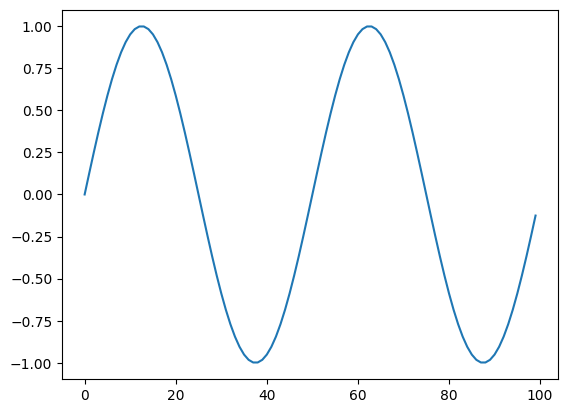

In [134]:
# Gravity, setting up masses
masses = []
springs = []

startPos =  (0,0)
pickedPoint = (50,1)


numOfMasses = 100
fullLengthPulled = 100

endPos = (startPos[0] + fullLengthPulled, startPos[1])

k = 3
eachMassLength = fullLengthPulled/numOfMasses
equiplibreiumLength = 60
equiplibreiumLengthPerMass = equiplibreiumLength/numOfMasses
totalMass = 1
massPerMass = totalMass/numOfMasses

for i in range(numOfMasses):
    masses.append(GravityMass(startPos[0] + i * eachMassLength, startPos[1], massPerMass))
for i in range(1,numOfMasses):
    springs.append(Spring(equiplibreiumLengthPerMass, k))

#Line pick

# for i, mass in enumerate(masses):
#     if i < pickedPoint[0]:
#         mass.y = ((pickedPoint[1] - startPos[1])/(pickedPoint[0] - startPos[0]))*(mass.x - startPos[0]) + startPos[1]
#     elif i > pickedPoint[0]:
#         mass.y = ((endPos[1] - pickedPoint[1])/(endPos[0] - pickedPoint[0]))*(mass.x - pickedPoint[0]) + pickedPoint[1]
# masses[pickedPoint[0]].y = pickedPoint[1]

# Sin wave
nodes = 2
for i, mass in enumerate(masses):
    mass.y = math.sin(mass.x * 2 * math.pi * 2/numOfMasses)

g = 0.01

#guasNum = 30
#damp = 30000000
#length = 50
#startI = round(numOfMasses/2) - round(guasNum/2)
#for i in range(guasNum):
    #springs[int(startI + i)].y = (math.e**-((i + length)**2)/length)*damp
    #print((math.e**-((i)**2)/length)*damp)

xs = [i.x for i in masses]
ys = [i.y for i in masses]
plt.plot(xs, ys)

In [135]:
dt = 0.01

def sim():
    for i in range(1, len(masses) - 1):
        mass = masses[i]
        spring = springs[i]

        #K0
        for j in [1,-1]:
            mass.calcForce(0,0, masses[i+j], spring)
        mass.addGravity(g)
        
        k0x, k0y = mass.returnAppliedForce(dt)

        #K1
        for j in [1,-1]:
            mass.calcForce(k0x/2,k0y/2, masses[i+j], spring)
        mass.addGravity(g)
    
    for i in range(1, len(masses) - 1):
        mass = masses[i]
        movement = mass.returnAppliedForce(dt/2)
        mass.x += movement[0]
        mass.y += movement[1]
            
pos = {'x' : [], 'y' : [], 'time' : [], 'id' : []}
#data = pd.DataFrame(pos)
for i in range(1000):
    sim()
    for num, j in enumerate(masses):
        pos['x'].append(j.x)
        pos['y'].append(j.y)
        pos['time'].append(i)
        pos['id'].append(num)
        #data.loc[len(data.index)] = [j.x, j.y, i, num]
#print(data)
#fig = px.line(pos, x="x", y="y", title='is a stirng', animation_frame="time", hover_name='id')
fig = px.scatter(pos, x="x", y="y", title='is a stirng', animation_frame="time", hover_name='id')
fig.layout.xaxis.range = (-0,fullLengthPulled)
fig.layout.yaxis.range = (-pickedPoint[1],pickedPoint[1])
fig.show()


#animation = FuncAnimation(fig, sim, frames = range(1,500))
#animation.save("spring.gif", dpi = 300, writer = PillowWriter(fps=30))